# All about Artificial Intelligence

## Allgemeines

### Definition

**Annahme:** <br> </br> Menschen tun das, was den meisten (erwartenden) Nutzen mit sich bringt. Ergo, Intelligenz = rationales Verhalten. AI ist System das rational handelt in Bezug auf bestimmte Problemklasse.

### Agententypen

Agent:
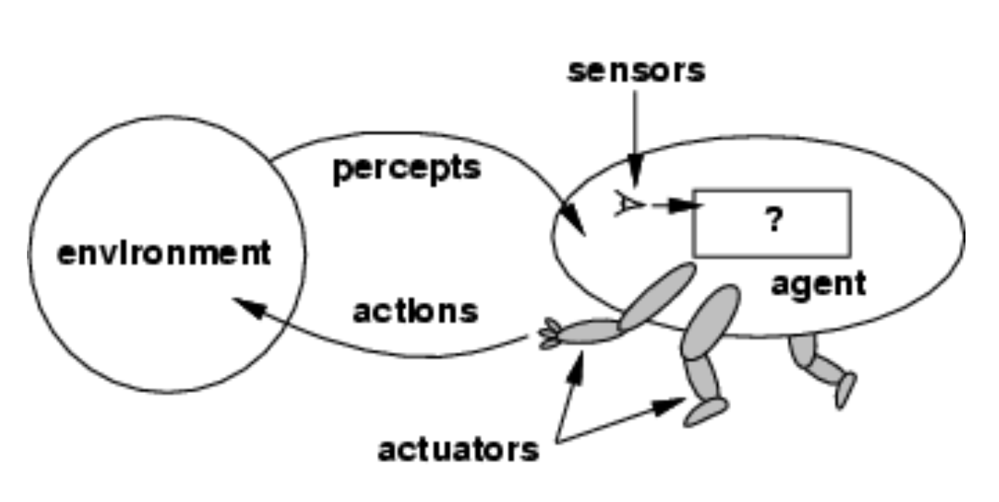


**Environment** = Physikalische Umwelt oder Abstraktion (Schachbrett, Google Maps) <br> </br>
**Percepts** = Verändern Wahrnehmung des Agenten (Durch Reward Model oder Funktion) <br> </br>
**Actuators** = Verändern die Umwelt <br> </br>
**Agententypen:**
- **Einfacher** Reflexagent
    - Kann keine komplexen Probleme lösen
    - Keine Vergangenheit, Repräsentation der Welt
    - If/else z.B. Computergegner
- **Modelbasierter** Reflexagent
    - Als Automat denkbar
    - Modell nur sehr implizit in Zuständen codiert
    - Ziel ebenfalls nur implizit codiert
- **Zielbasierter** Reflexagent
    - Repräsentation der Umwelt
    - Ziel als Menge erstrebenswerter Zustände
    - Auf konkrete Problemumgebung angepasst
- **Nutzenbasierter** Reflexagent
    - Abstrakte Nutzenfunktion erlaubt flexible Auswahl/Definition des (höheren/besseren) Ziels




### Problemeigenschaften

- **Vollständig beobachtbar vs. teilweise beobachtbar:**
    - Tic-Tac-Toe, Schach, Go sind vollständig beobachtbar (alle Zustände sind abbildbar). Schiffe versenken, Poker nur teilweise beobachtbar.
- **Deterministisch vs. stochastisch:**
    - Tic-Tac-Toe ist deterministisch (Jeder zukünftige Zustand wird durch den jetztigen bestimmt). Mau-Mau ist stochastisch (Der Zufall spielt beim nächsten Zustand eine Rolle bspw. ob jemand eine 7-Karte vom Stapel aufnehmen muss).
- **Episodisch vs. sequenziell:**
    - In episodischen Umgebungen hängen nachfolgende Episoden nicht von früheren Episoden ab. Ein Roboter der Tomatensauce auf Pizzen, die nacheinander auf einem Laufband laufen, spritzt (episodisch) vs. Ein Roboter der Bauklötze zu einem hohen Turm stapelt (sequenziell).
- **Statisch vs. dynamisch:**
    - Eine Umgebung die sich verändert während der Agent seine Handlung überlegt ist dynamisch (Autofahren). Ändert sich mit der Zeit nur die Performanz des Agenten ist es semidynamisch (Online Shopping).
- **diskret vs. kontinuierlich:**
    - Es gibt eine begrenzte Anzahl klar definierter Aktionen und Wahrnehmungen und die Zustände sind endlich, dann ist das Problem diskret.
- **Single vs. Multiagent:**
    - Wann muss ein Agent A eine Einheit B als Agent betrachten? Wenn Verhalten von B damit beschrieben werden kann, dass es eine Leistungsbewertung von A maximiert. (A und B können konkurrieren oder kooperieren).

###### Problemformulierung

- **Ausgangszustand** := Anfangszustand des Agenten
- **Aktionen und Wirkung** := Beschreibung möglicher Aktionen und deren Outcome (Indirekte Repräsentation des Zustandraums).
- **Zielzustand** := Ein erstrebenswerter Terminalzustand
- **Kostenfunktion** := Kosten der Sequenz von Handlungen
<br> </br>

=> <b>Lösung eines Suchproblems ist eine Sequenz von Handlungen, die vom Ausgangs- in einen Zielzustand führt.</b>

###### 8-Damen-Problem Beispiel

!
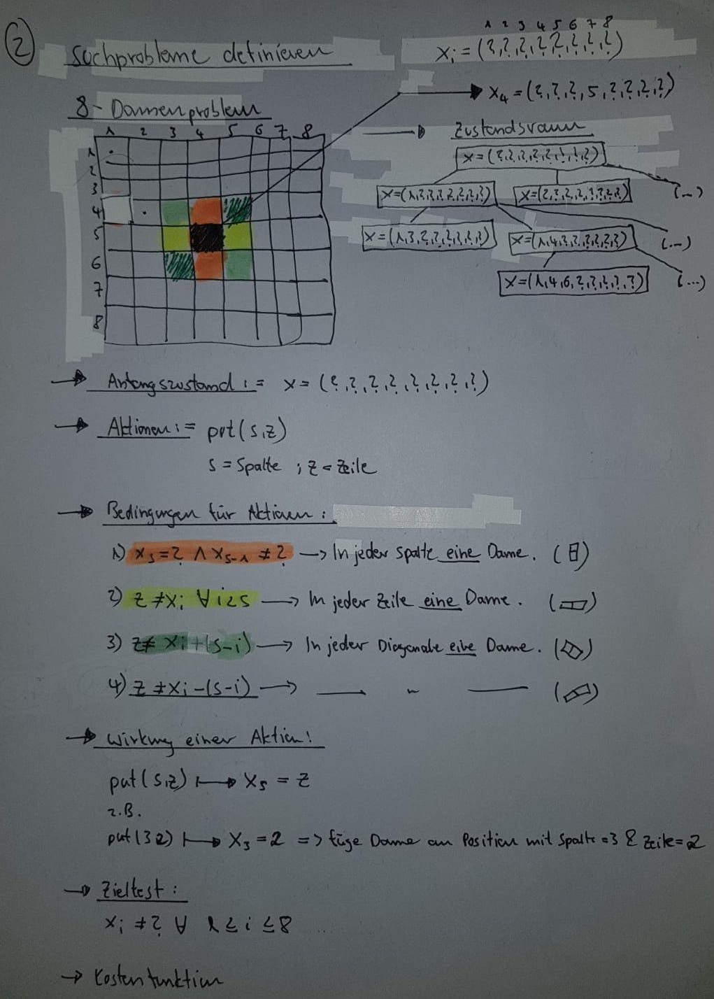

## Suche nach Wege und Zustände

Übersicht
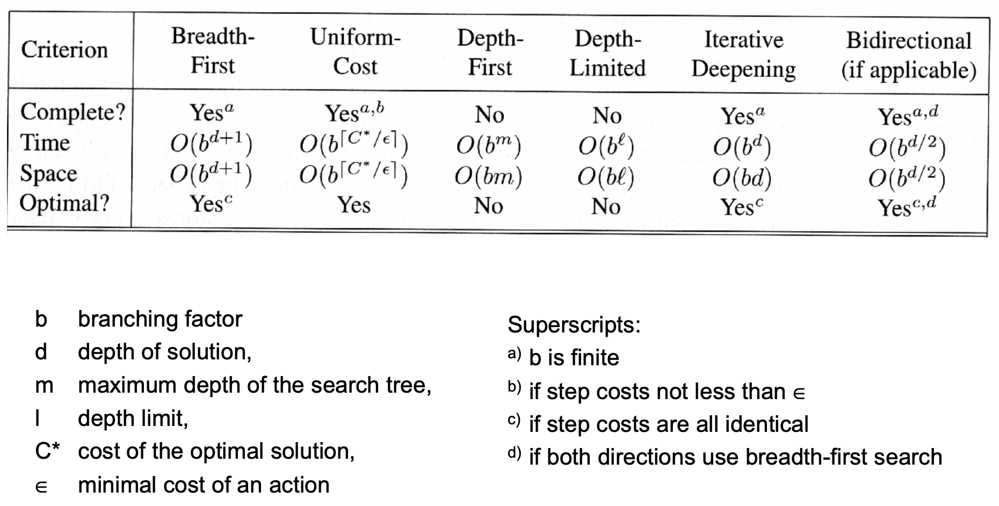

- **Polynomial = n^2 (general)**
- **Exponential = 2^n (general)**
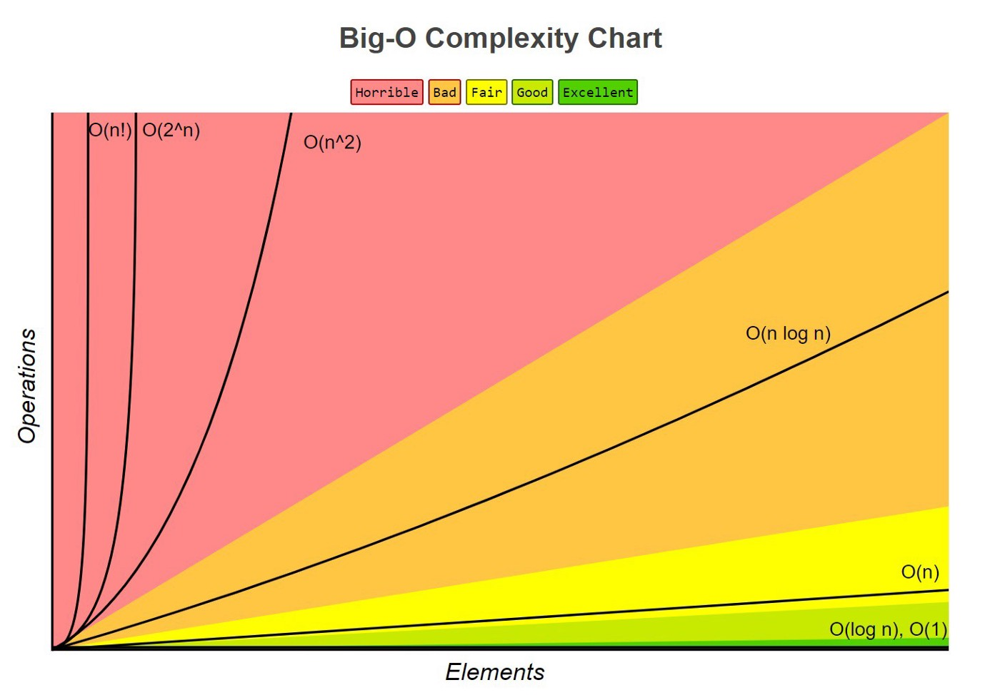

###### Excurs - Data Structures in Python 

Data Structures
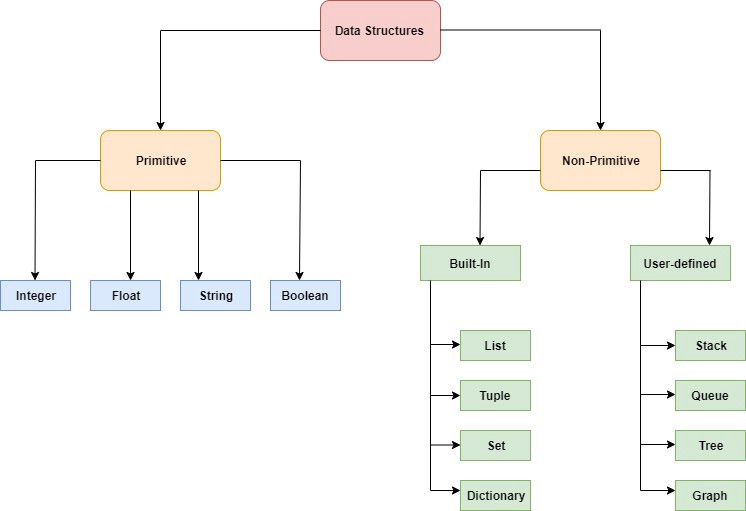

### Breitensuche

BFS (FIFO, Queue [sequencial processing], generell Speicherproblem)
- Black = explored
- Grey = queued to be explored later on
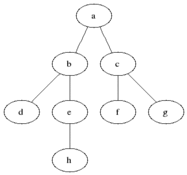

In [11]:
graph = {
  'A' : ['B','C'],
  'B' : ['D', 'E'],
  'C' : ['F', 'G'],
  'D' : [],
  'E' : ['H'],
  'F' : [],
  'G' : [],
  'H' : []
}

visited = [] # List to keep track of visited nodes. #!!! duplicates allowed with list
queue = []     # Initialize a queue

def bfs(visited, graph, node):
  visited.append(node)
  queue.append(node)

  while queue:
    s = queue.pop(0) # Take out first element in list
    print (s, end = " ") 

    for neighbour in graph[s]: # Checks nodes of vertexes e.g. vertex A has B and C as neighbour
      if neighbour not in visited:
        visited.append(neighbour)
        queue.append(neighbour)

# Driver Code
bfs(visited, graph, 'A')

A B C D E F G H 

### Tiefensuche 

DFS (LIFO, Stack [recursion] evtl. keine optimale Lösung)
- Gute Verbesserungen:
    - Backtracking (Untersucht immer nur ein Pfad)
    - Iterativ (Kombiniert gute Eigenschaft von Tiefen- und Breitensuche, aber wiederholt Phasen zuvor)
    - Tiefenbegrenzend
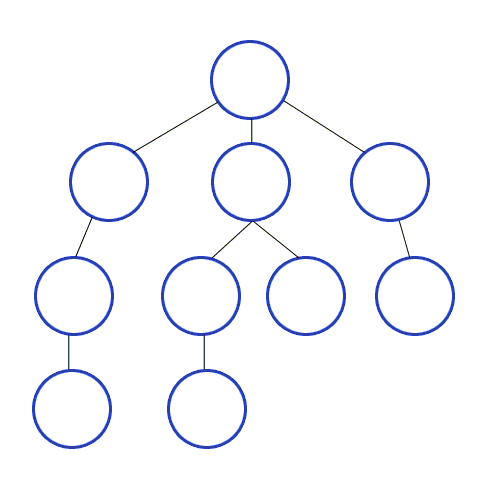

In [16]:
# iterative 

graph = {
    '1'  : ['2','5','9'],
    '2'  : ['3'],
    '3'  : ['4'],
    '4'  : [],
    '5'  : ['6','8'],
    '6'  : ['7'],
    '7'  : [],
    '8'  : [],
    '9'  : ['10'],
    '10' : []
}

visited = set()

def dfs(visited,graph,node):
    if node not in visited:
        print(node, end = " ")
        visited.add(node)
        for n in graph[node]:
            dfs(visited,graph,n)

dfs(visited,graph,'1')


1 2 3 4 5 6 7 8 9 10 

###### Backtracking Suche

In [18]:
# pruned dfs with recursion alias backtracking

graph = {
    '1'  : ['2','5','9'],
    '2'  : ['3'],
    '3'  : ['4'],
    '4'  : [],
    '5'  : ['6','8'],
    '6'  : ['7'],
    '7'  : [],
    '8'  : [],
    '9'  : ['10'],
    '10' : []
}

visited = set() # Set to keep track of visited nodes. Can't change items, but you can add more

def dfs(visited, graph, node):
    if node not in visited:
        print (node, end = ' ')
        visited.add(node)
        for neighbour in graph[node]:
            dfs(visited, graph, neighbour) # Recursive call

# Driver Code
dfs(visited, graph, '1')


1 2 3 4 5 6 7 8 9 10 

### Duplikateliminierung

In [21]:
# BFS without duplicates by using set() in order to prune the search space 

graph = {
  'A' : ['B','C'],
  'B' : ['D', 'E'],
  'C' : ['F', 'G'],
  'D' : [],
  'E' : ['H','I','H','I','H','I'],
  'F' : [],
  'G' : [],
  'H' : []
}

visited = set() # using set instead of list avoids duplicates and **prunes the search space**
queue = []     # Initialize a queue

def bfs(visited, graph, node):
  visited.add(node)
  queue.append(node)

  while queue:
    s = queue.pop(0) # Take out first element in list
    print (s, end = " ") 
    
    try:
        for neighbour in graph[s]: # Checks nodes of vertexes e.g. vertex A has B and C as neighbour
          if neighbour not in visited:
            visited.add(neighbour)
            queue.append(neighbour)
    
    except KeyError:
        pass

# Driver Code
bfs(visited, graph, 'A')

A B C D E F G H I 

### Uniforme Kostensuche 
Uniform Cost Search. It's like a depth first search, but it traverses first the branches with the lowest accumulated travel cost. It gets to the goal through the lowest cost route, although not in the fastest way.
- uses path with least cumulative costs
- implemented with priority queue
- **Complexity:**
    - Time (and Space) Complexity = O(b^1+C*/e)
        - C* cost of optimal solution
        - e is each step getting closer to solution node
        - It is complete and optimal

- Uniform Cost Search. It's like a depth first search, but it traverses first the branches with the lowest accumulated travel cost. It gets to the goal through the lowest cost route, although not in the fastest way.
- **Bestensuche (Kostensensitiv)**
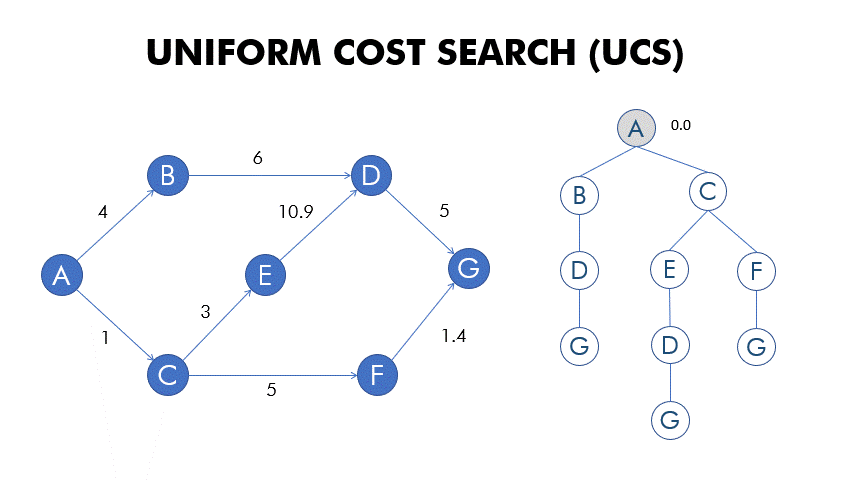

### A* Suche

- A* search algorithm. It works just like the uniform cost search, but to decide which branch to continue exploring it adds to the accumulated cost an estimate of how close we are to the goal (In our example the straight-line distance to the G city). It rapidly finds the best route to the goal, so it is one of the most used algorithms.
- for graph traversion and finding (best) path i.e. for Travelling Salesman Problem
- **Bestensuche (kostensensitiv)**
- **Complexity:**
    - Time (and Space) Complexity = O(b^d) [in general but it depends on use case and heuristic]
    - Complete and optimal
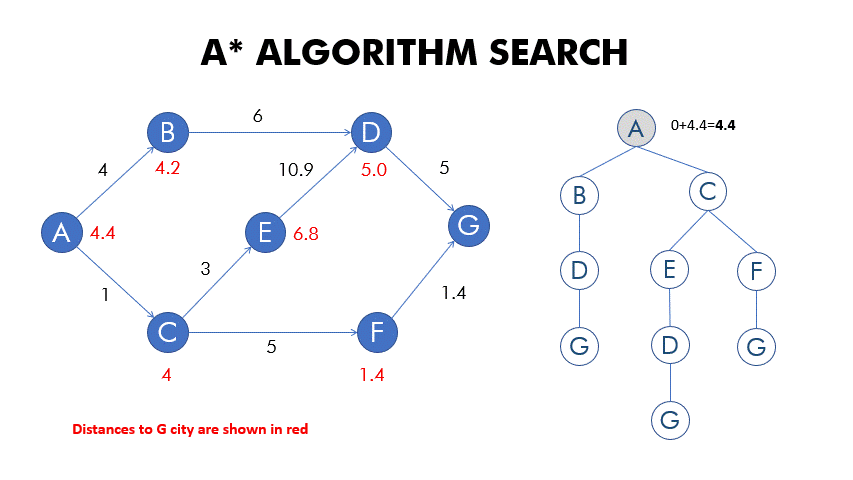

In [32]:
# Algorithm

# tree dictionary stores child nodes and edge cost for each vertex
tree = {'A': [['B', 4], ['C', 1]],
        'B': [['D', 6]],
        'C': [['E', 3], ['F', 5]],
        'D': [['G', 5]],
        'E': [['D', 10.9]],
        'F': [['G', 1.4]],
        'G': []
        }

# heuristic dictionary stores heuristic values of each vertex
heuristic = {'A': 4.4, 'B': 4.2, 'C': 4, 'D': 5.0, 'E': 6.8, 'F': 1.4, 'G': 0} 

cost = {'A': 0}             # total cost for nodes visited


def AStarSearch():
    global tree, heuristic
    closed = []             # closed nodes
    opened = [['A', 4.4]]     # opened nodes

    '''find the visited nodes'''
    while True:
        fn = [i[1] for i in opened]     # fn = f(n) = g(n) + h(n)
        chosen_index = fn.index(min(fn))
        node = opened[chosen_index][0]  # current node
        closed.append(opened[chosen_index])
        del opened[chosen_index]
        if closed[-1][0] == 'G':        # break the loop if node G has been found
            break
        for item in tree[node]:
            if item[0] in [closed_item[0] for closed_item in closed]:
                continue
            cost.update({item[0]: cost[node] + item[1]})            # add nodes to cost dictionary
            fn_node = cost[node] + heuristic[item[0]] + item[1]     # calculate f(n) of current node
            temp = [item[0], fn_node]
            opened.append(temp)                                     # store f(n) of current node in array opened

    '''find optimal sequence'''
    trace_node = 'G'                        # correct optimal tracing node, initialize as node G
    optimal_sequence = ['G']                # optimal node sequence
    for i in range(len(closed)-2, -1, -1):
        check_node = closed[i][0]           # current node
        if trace_node in [children[0] for children in tree[check_node]]:
            children_costs = [temp[1] for temp in tree[check_node]]
            children_nodes = [temp[0] for temp in tree[check_node]]

            '''check whether h(s) + g(s) = f(s). If so, append current node to optimal sequence
            change the correct optimal tracing node to current node'''
            if cost[check_node] + children_costs[children_nodes.index(trace_node)] == cost[trace_node]:
                optimal_sequence.append(check_node)
                trace_node = check_node
    optimal_sequence.reverse()              # reverse the optimal sequence

    return closed, optimal_sequence


if __name__ == '__main__':
    visited_nodes, optimal_nodes = AStarSearch()
    print('visited nodes: ' + str(visited_nodes))
    print('optimal nodes sequence: ' + str(optimal_nodes))


visited nodes: [['A', 4.4], ['C', 5], ['F', 7.4], ['G', 7.4]]
optimal nodes sequence: ['A', 'C', 'F', 'G']


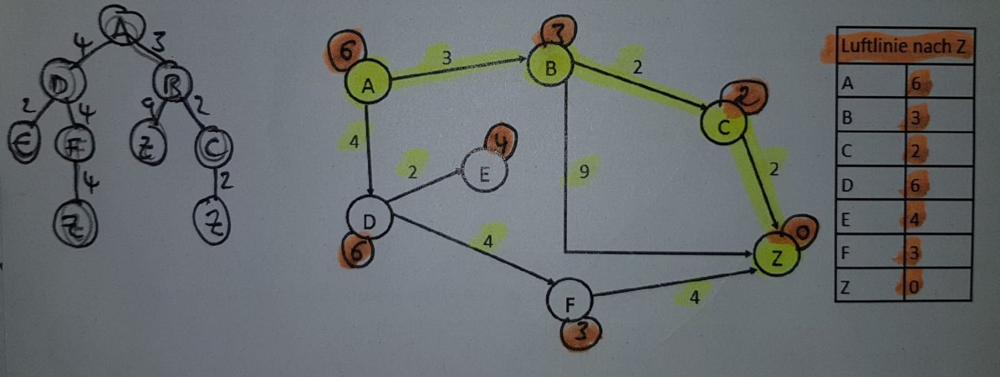

#### Admissibility Heuristic
- the **estimated cost** (**orange**) must always be **≤** to the **actual cost** (**yellow**) of reaching the goal state from the **current** node.

    - Uniforme Kostensuche := f(n) = g(n) 
    - A*-Suche := f(n) = g(n) + h(n)
    - Greedy Suche := f(n) = h(n)

### Greedy Suche
- Bei Maximierungsproblem (ähnlich standard hill climbing)

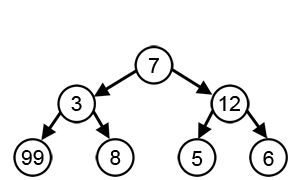

### Lokale Suche
- Kein Zustands-Pfad zum Ziel wird aufgebaut. Nur ein Zustand wird systematisch verändert in Richtung des Zielzustandes.
- Wertigkeit eines Zustands kann mithilfe einer Zielfunktion berechnet werden.
- **Optimierungsprobleme** (find min or max) sind Beispiele für Probleme, die sich gut mit lokaler Suche lösen lässt.
- **Vorteile:**
    - Geringer Speicherbedarf, in sehr großen Zustandsräumen anwendbar (wo optimale Verfahren nicht mehr anwendbar sind).
- **Nachteil:**
    - Optimalität nicht gewährleistet
    - Güte einer gefunden Lösung schwer einschätzbar bei sehr großem Zustandsraum und keine Erkenntnisse von optimaler Lösung
- **Optimierungen:**
    - Iterative Durchführung
    - Kontrolliertes randomisiertes Verhalten
    - Informationsaustausch
    - Kombinieren von ‚guten Zwischenergebnisen‘


#### Hill-Climbing


Zustandsraum (X-Achse) und Funktion (Y-Achse)
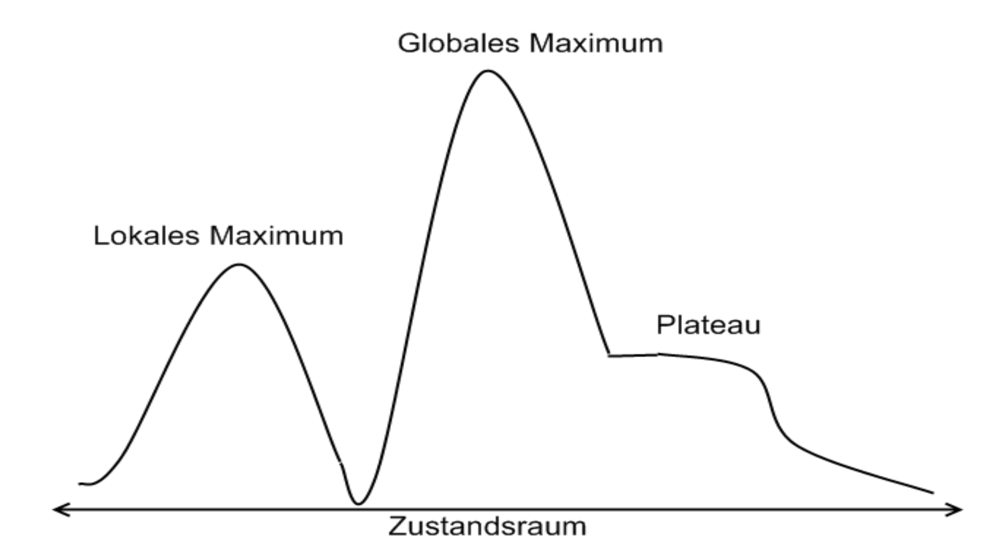

**Algorithm: (Simple) Hill Climbing**
1. Let current node be an initial state.
2. If current node is a goal state, STOP (solution found)
3. If current node has no more successor, STOP (no solution found)
4. If successor is better than the current node, make the successor a currentnode. Go to 2.
-  **ALWAYS CHOSE THE BEST NEIGHBOUR (!)**

<br> </br>
**Note: “better” can mean lower or higher value. E.g.,**
 - If h(n) = cost from n to a goal state then “better” = lower value
 - If h(n) = profit in state n then “better” = higher value
 <br> </br>
 
 

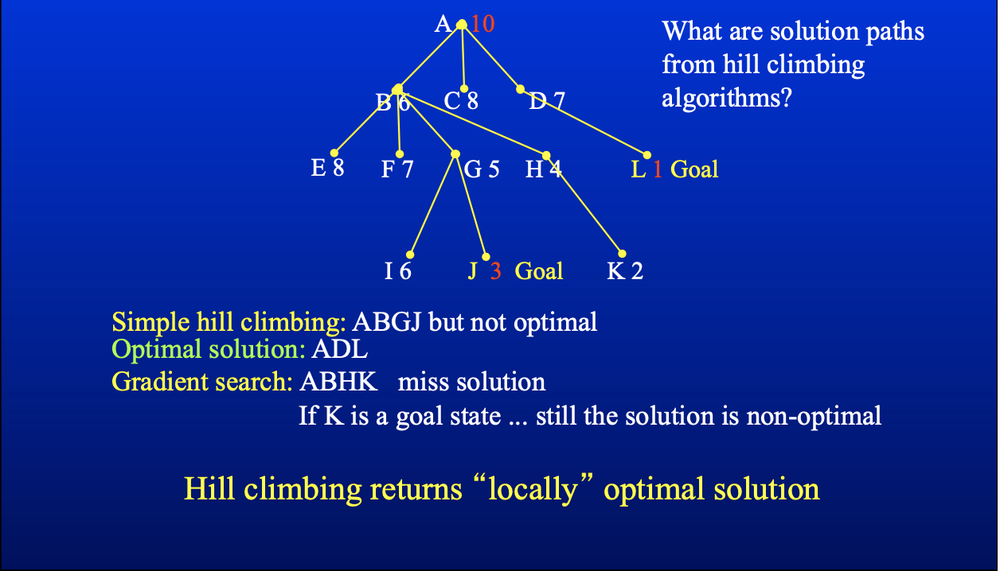

#### Further optimized hill-climbing heuristics

##### Stochastic Hill-Climbing

- Wähle zufällig unter Aufwärts(-abwärts)zügen aus.
    - Konvergiert langsamer, aber bei bestimmten Zustandsräumen optimaler.

##### First Choice Hill-Climbing

- Ziele zufällig Nachfolger, bis ein besserer als der aktuelle Zustand gefunden wird
    - Für Probleme mit sehr hoher Nachfolgeranzahl

##### New Start Hill-Climbing

- Starte erneut von einem (anderen) Zustand (kann auch selbe sein, aber sehr unwahrscheinlich), bis optimale Lösung gefunden wird bzw. Abbruch nach n Versuchen.

##### Gradient Descent

**Problem:**
Gegeben 𝑓 ∶ 𝑅𝑛 → 𝑅, finde 𝑥 ∈ 𝑅 unter dem 𝑓(𝑥) minimal (maximal) wird, wobei f eine differenzierbare Funktion ist
- Man wählt einen zufälligen Wert für x und geht in die Richtung (Schrittweite = alpha) , die durch den Gradienten vorgegeben wird
- ein Zustand hat per se keine feste Anzahl an Nachbarn (Was ein Nachbar ist hängt davon ab, wie man 𝛼 setzt) 
- Die reelen Zahlen sind kontinuierlich (und keine Felder eines Schachbretts)
    - 𝛼 zu hoch => man springt um das Minimum herum
    - 𝛼 zu klein => es dauert lange bis man beim Minimum ist
- Es wird immer der „Nachbar“ gewählt, der dem steilsten Abstieg entspricht
    - Genau wie beim Standard Hill Climbing
    - Analoge Probleme mit lokalen Maxima und Plateaus
- Wird oft im Kontext von Machine Learning verwendet
- **Nur anwendbar wenn Zustandraum über eine differenzierbare Funktion beschrieben werden kann**

#### Simulated-Annealing

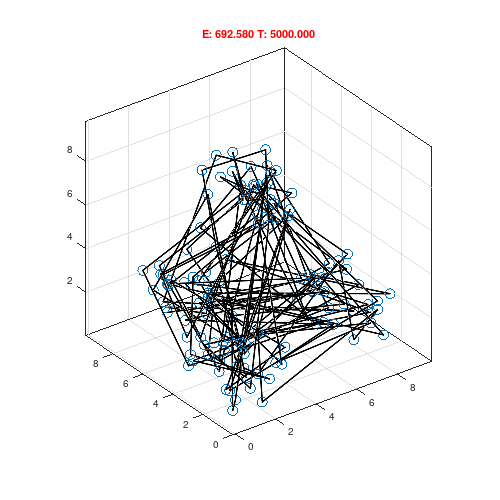

**Allows random moves to escape local max**
- can temporarily move to a worse state to avoid being stuck, i.e., 
    - If state is better then move, else move with prob. < 1, where the prob. of the “badness” of the move decreases exponentially
- Analogous to annealing metals to cool molten metal to solid
- A transition to a higher energy state in cooling process occurs with probability p, where
     - p = e ^ (-ΔΕ / T)
     - ΔΕ = change in energy level (costs)
     - T = Temperature

Note:
- p is propositional to T
- T initially increases then decreases
- High T --> Exploration of Search Space and Acceptance of worse solution
- Low T --> Exploitation of Search Space and Convergence towards (best) solution

- **Algorithmus (Minimierungsproblem für f(x))**
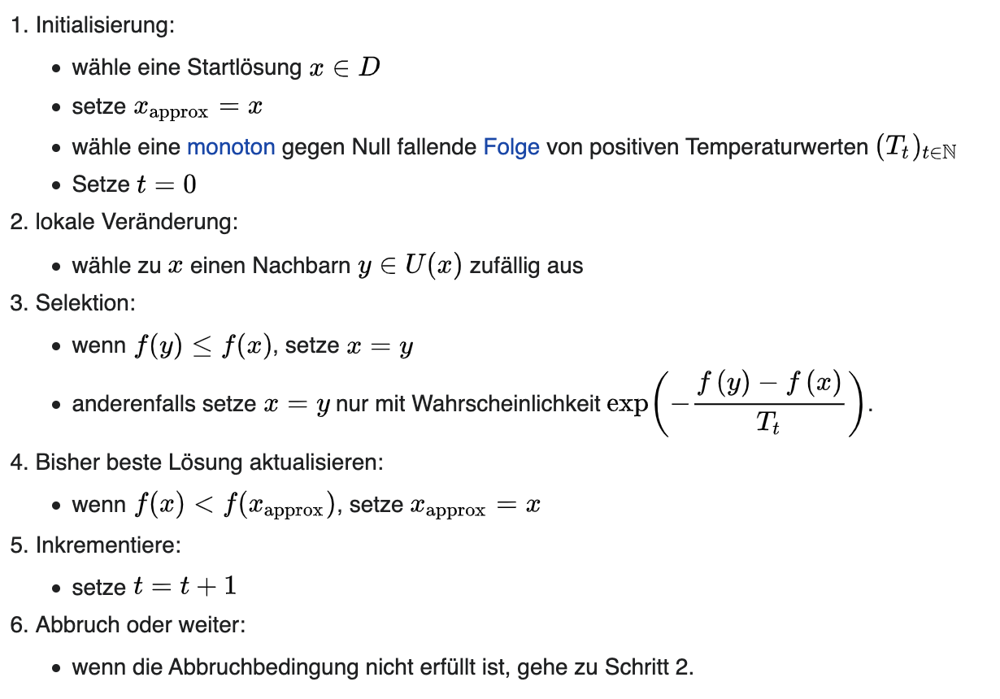

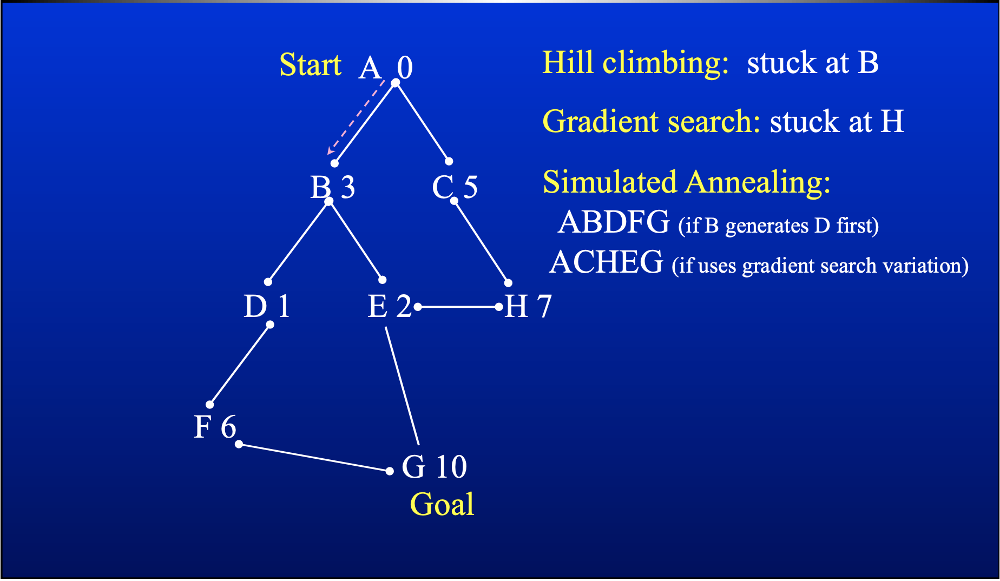

#### Local Beam-Search

- kind of best-first-search with depth limit n keeping only n most promising states in S
- mix of DFS and BFS
- Intuition: Follow single path but switch if competing path is better


Tree Traversal
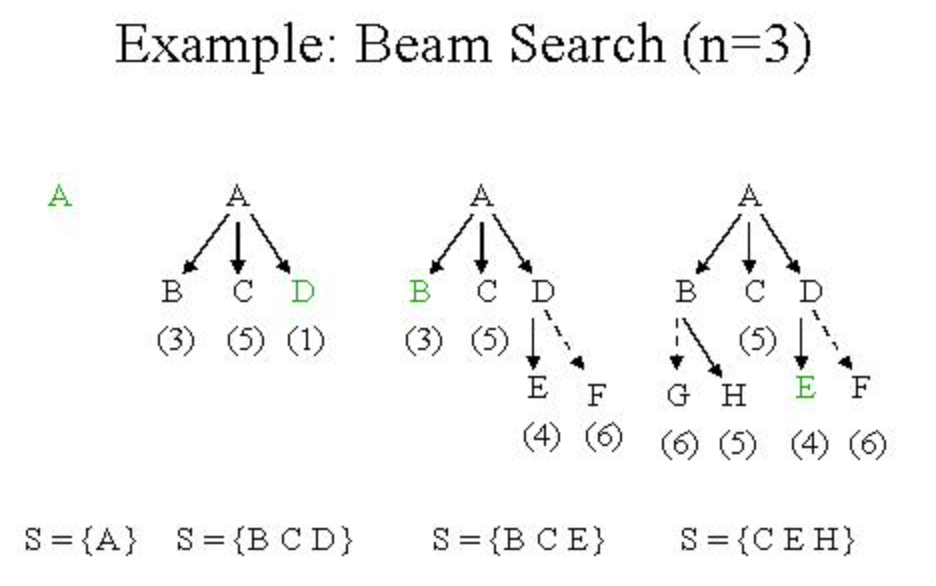

#### Genetische Algorithmen

- eine Art stochastische local beam search (um so Konzentrierung auf wenige Strahlen zu minimieren)
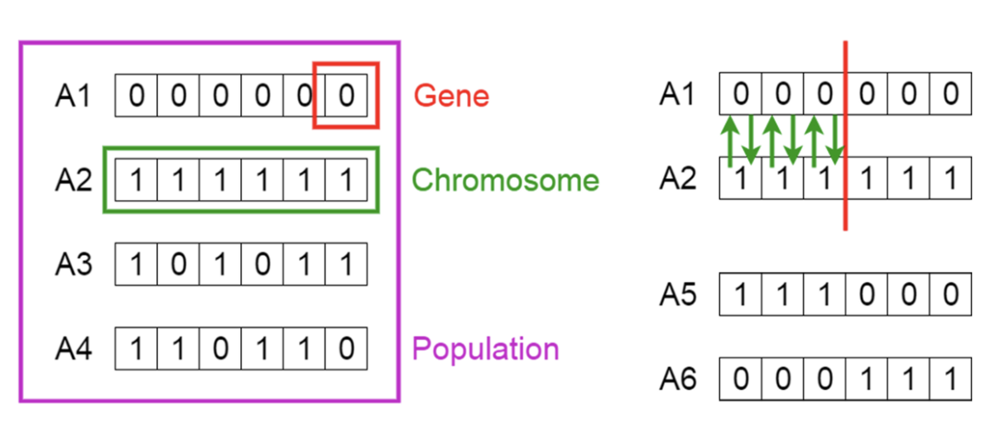

**Five Phases considered in GA:**
1) Initial population

2) Fitness function

3) Selection

4) Crossover

5) Mutation
<br> </br> 
- **Algorithmus:**
- START
    - Generate the initial population
    - Compute fitness
- REPEAT
    - Selection
    - Crossover
    - Mutation
    - Compute fitness
- UNTIL population has converged
- STOP



### Spielbaumsuche
- look ahead for future positions in order to make a good current position/move

#### Minimax Search
- fully observable and deterministic multi-agents
- uses heuristic 
- similar to depth limited search
- balanced tree search



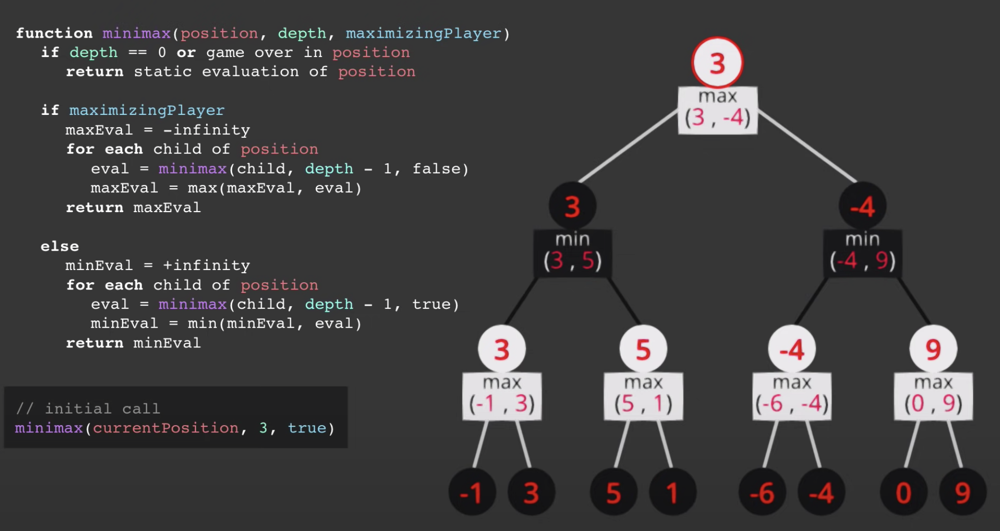

#### Minimax Search with Alpha Beta Pruning
- optimizing the search space
- pruning is not guaranteed to occur
- ideally order is from best to worst for player whos turn it is in position (starting from left as it is DFS)



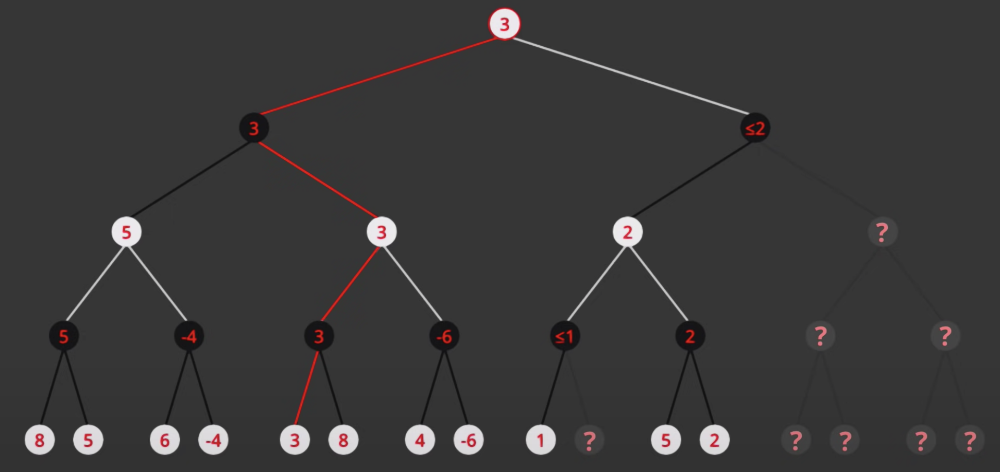

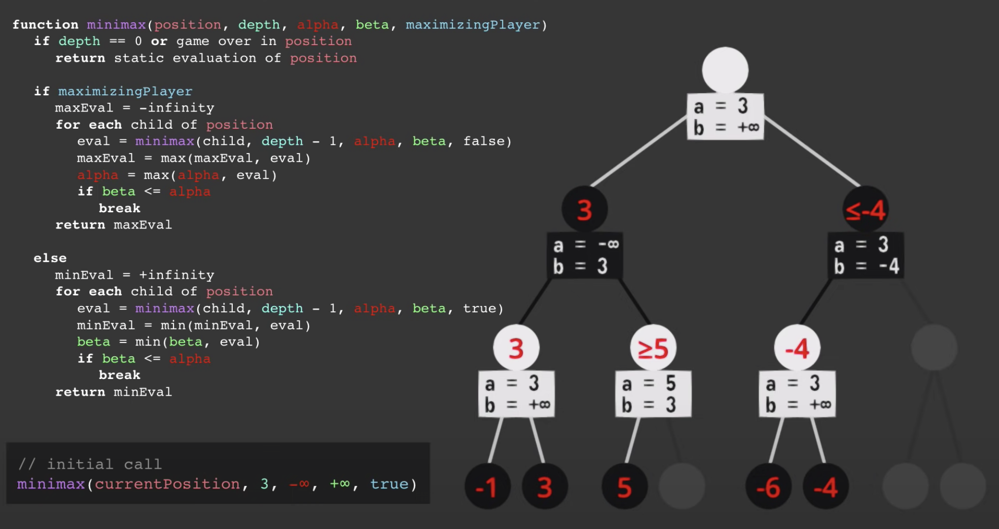

#### Other Minimax Optimizations
- Vorsortierung der Züge
    - Führe erst vielversprechende Züge aus
    - Verschiedene Ansätze um das zu erkennen
- Iterative Tiefensuche
    - Verwendung zur besseren Vorsortierung
    - Ergebnisse Level n bestimmt Reihenfolge auf Level n+1
- Spielspezifische Heuristik
    - Schach: Erst Züge betrachten, die Figuren schlagen
    - Bohnenspiel: Erst Züge betrachten, die bedrohte Felder sichern
- Killer Heuristik
    - Guter Zug in einem Teilbaum = guter Zug in anderem Teilbaum



#### Expectimax
- fully observable and stochastic
- Minimax Werte werden zusätzlich in Abhängigkeit von Wahrscheinlichkeiten der Zustände berücksichtigt
- Oft nicht effizient, da Change Nodes den Suchraum explodieren lassen



Spiel mit Münzwurf
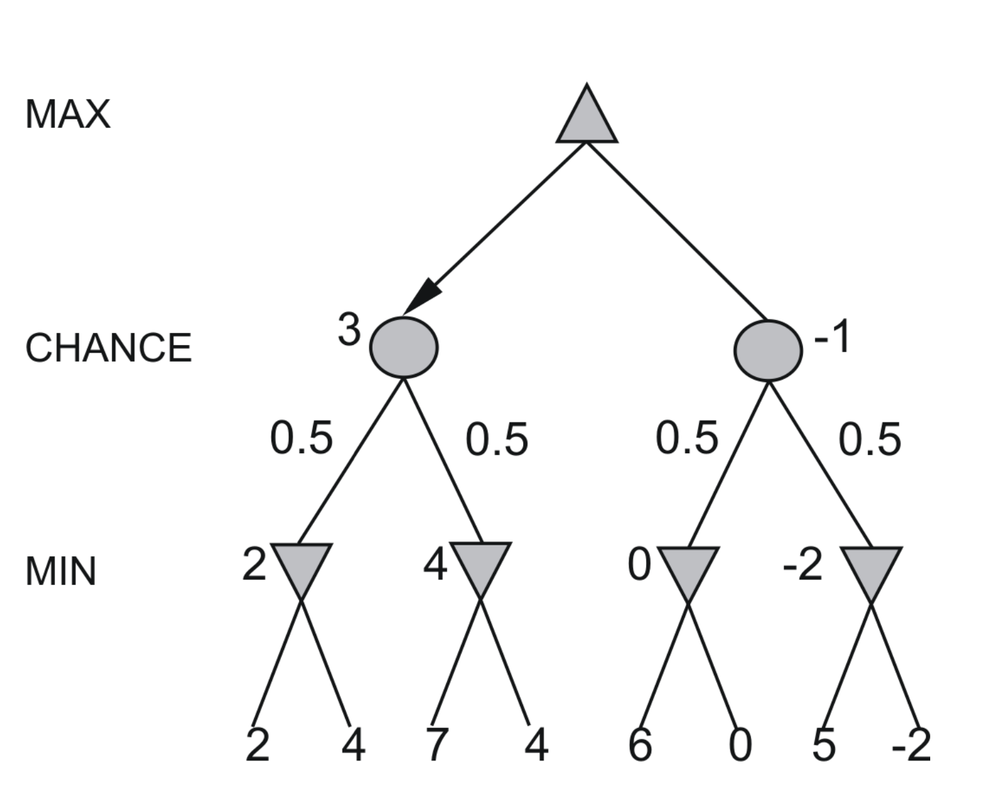

#### MCTS

- partially observable and stochastic
- reinforcemant learning (simulation win is reward simulation loss is penalty)
- no heuristic instead MCTS uses statistic of aggregated simulationevaluations (**Upper Confidence Bound [UCB]**)
- no balanced tree search (similar to A* Search)

   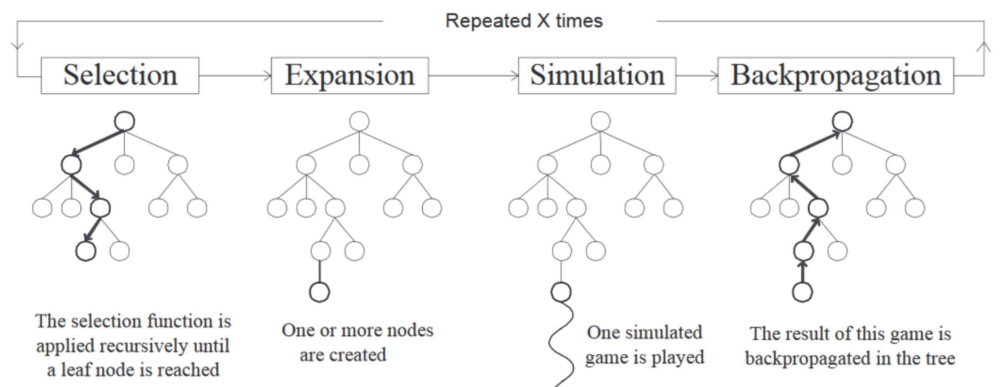
- **Selektion**
    - Wähle Node mit **größten** UCB Score
        - Hohes C --> Exploration
        - Niedriges C --> Exploitation
        - Gutes C ist Wurzel 2 (Kocsis & Szepesvari et al.)
- **Expansion**
    - Variante 1: Erzeuge alle Kinder mit Initialisierung 0 und führe Simulation überall durch
        - Teuer bei hohem Branching-Factor
    - Variante 2: Erzeuge zufällig ausgewählten Kindknoten mit Initialisierung 0
        - Sinnvoll bei hohem Branching-Faktor
- **Simulation**
    - Light Playout: Vollständig zufällig
        - Simulation dauert kürzer 
    - Heavy Playout: Zuällig vermischt mit Heuristik (z.B. MCTS mit tiefenbeschränkter Min-Max-Suche)
        - Simulation dauert länger aber besser bei gleicher Iterationen bei Light und Heavy Playout
    - Abbrechen
        - Bei Spielen mit vielen Zügen macht es Sinn, Simulation vorher abzubrechen
            - nach bestimmter Suchtiefe oder
            - Heuristikwert wird alle m Züge berechnet, bei klarem Ausschlag
            - Bei Domain Knowledge effiziente Gestaltung der MCTS da klare Terminalbedingungen
- **Propagieren**



!
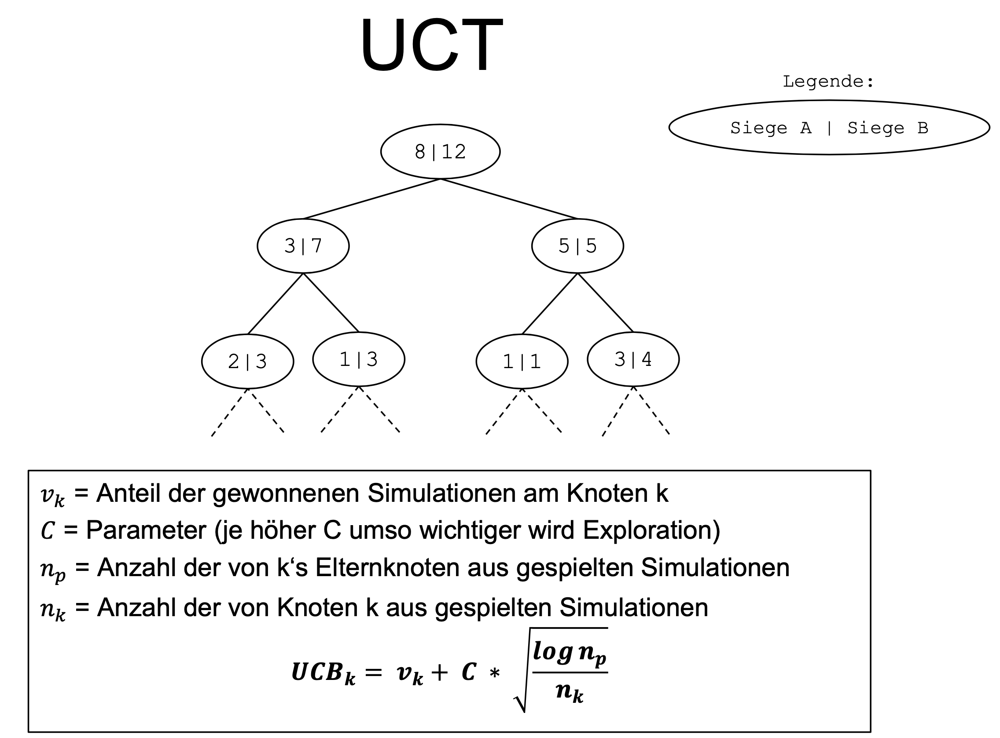

## Suche nach Zustände

### Constraint-Probleme 

- Spezialfall von Suchproblemen
- Zustände im Suchraum haben eine vorgegeben Struktur
- Diese Struktur erlaubt es problem-unabhängige Heuristiken anzuwenden
    - anstall problemspezifische Heuristiken bei Suchproblemen
<br> </br>
- **Struktur** von Constraint-Problemen:
        - Variable X = {...}
        - Definitionsbereich D = {...}
        - Constraints C = {...}
- **Beispiel:**
        - X1 = {1,3,4}
        - D = natürliche Zahlen
        - C1 = {X1 ≠ 2; X1 < 5}
        - X1 erfüllt Constraint C1 und ist konsistent

###### Backtracking

- Tiefensuche auf partiellen Belegungen
- In jedem Schritt wird einer Variable ein Wert zugeordnet
- Führt keine mögliche Zuordnung zu einer konsistenten Belegung wird zurückgegangen (Backtracking)
- Laufzeitkomplexität: O(b^m) (uneffizient)
<br> </br>
- **Beispiel:**
    - X1 = {1,2,3}
    - X2 = {1,2,3}
    - X3 = {1,2,3}
    - C1 = X1 > X2
    - C2 = X2 ≠ X3
    - C3 = X1 ≠ X3
        - 1 Iteration := X1 = 1, X2 = 1 --> C1 - X
        - 2 Iteration := X1 = 1, X2 = 2 --> C1 - X
        - 3 Iteration := X1 = 1, X2 = 3 --> C1 - X
        - 4 Iteration := X1 = 2, X2 = 1 --> C1 - √
        - 5 Iteration := X1 = 2, X2 = 1, X3 = 1 --> C1 - √ | C2 - X
        - 6 Iteration := X1 = 2, X2 = 1, X3 = 2 --> C1 - √ | C2 - √ | C3 - X
        - 7 Iteration := X1 = 2, X2 = 1, X3 = 3 --> C1 - √ | C2 - √ | C3 - √
<br> </br>
- **Problem:**
    - dead-ends, die Backtracking erzwingen
    - Kein Backtracking = lineare Laufzeit
<br> </br>  
- **Ziel:**
    - Vermeidung von dead-ends durch:
        - Intelligente Auswahl von Variablen
            - Degree Heuristic
            - Minimum Remaining Values
        - Intelligente Auswahl von Werten
            - Least Constraint Value
        - Einschränkung des Suchraums
<br> </br>
- **Verbesserte Heuristiken:**
    - Backjumping
    - **Conflict Directed Backjumping** (!)
    - Forward Checking
    - Constraint Propagation

!
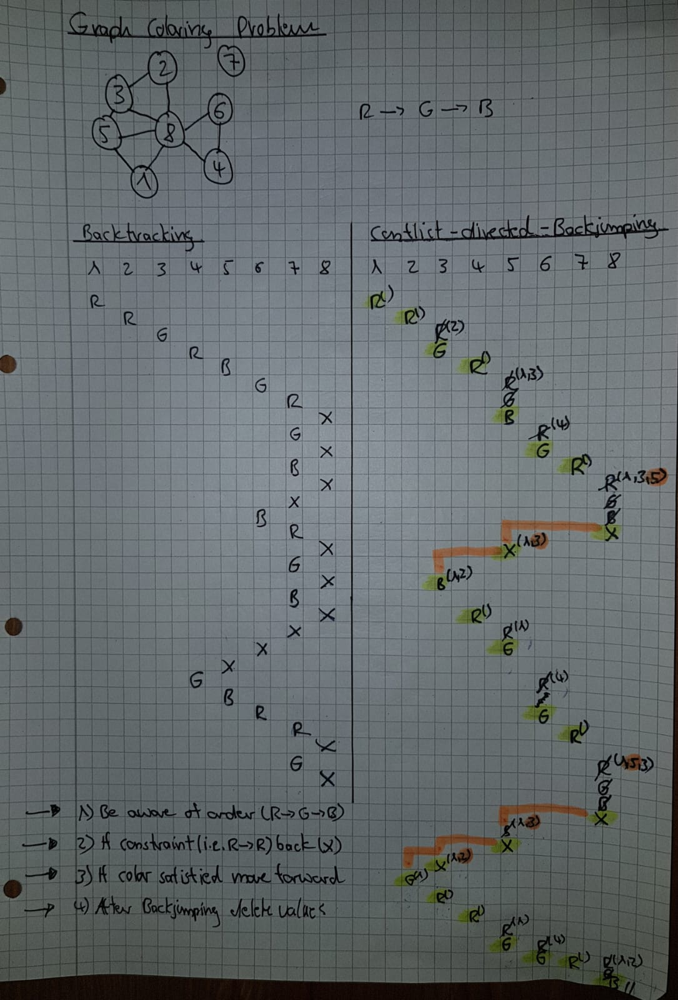

In [ ]:
# Backtracking solving Sudoku

import numpy as np

grid = [[5,3,0,0,7,0,0,0,0],
        [6,0,0,1,9,5,0,0,0],
        [0,9,8,0,0,0,0,6,0],
        [8,0,0,0,6,0,0,0,3],
        [4,0,0,8,0,3,0,0,1],
        [7,0,0,0,2,0,0,0,6],
        [0,6,0,0,0,0,2,8,0],
        [0,0,0,4,1,9,0,0,5],
        [0,0,0,0,8,0,0,7,9]]

#print(np.matrix(grid))

# Write helper constraint function which checks row and column for already existing n
def possible (x,y,n):
    global grid
    # check if number is in row
    for i in range(0,9):
        if grid[x][i] == n:
            return False
    # check if number is in column   
    for i in range(0,9):
        if grid[i][y] == n:
            return False
    # check if number is in a 3x3 grid (for pruning/constraining the search space furthermore)
    x0 = (x//3)*3
    y0 = (y//3)*3
    for i in range(0,3):
        for j in range(0,3):
            if grid[x0+i][y0+j] == n:
                return False
       
    return True
        
#print(possible(1,1,1)) # should return False
#print(possible(0,0,1)) # should return True

# Create Backtracking function with recursion
def solve():
    global grid
    # find empty position
    for x in range(9):
        for y in range(9):
            if grid[x][y] == 0:
                # if empty position found put a number from 1 to 9 in cell
                for n in range(1,10):
                    if possible(x,y,n):
                        grid[x][y] = n
                        # now we have reduced the problem - we have one 3x3 square less 
                        # so we call the solve () function again and find another empty square
                        solve()
                        # maybe our choice is not possible (False) - then we have a dead end
                        # Then we need to backtrack. We go back and take it out.
                        grid[x][y] = 0
                # If we have tried all possibilities for an empty square and none
                # of those worked we're again in a dead end then we return (Backjumping)
                return
    # If we found a solution but some cells are still empty, we end up here
    # A good Sudoku would only have one solution without any empty cells

    print("The solution Sudoku grid looks like that: \n \n", np.matrix(grid))
    input("\nHere are more solutions:")
    print("No more solutions - already found the best one!")

solve()

The solution Sudoku grid looks like that: 
 
 [[5 3 4 6 7 8 9 1 2]
 [6 7 2 1 9 5 3 4 8]
 [1 9 8 3 4 2 5 6 7]
 [8 5 9 7 6 1 4 2 3]
 [4 2 6 8 5 3 7 9 1]
 [7 1 3 9 2 4 8 5 6]
 [9 6 1 5 3 7 2 8 4]
 [2 8 7 4 1 9 6 3 5]
 [3 4 5 2 8 6 1 7 9]]

Here are more solutions:


### Logik 

- Menge von Formel aus KNF rausschreiben. Dann wird Problem gelöst indem Schlussfolgerungsalgorithmus angewendet wird.
- **Knowledge Base (KB)** ist eine "große" Konjunktion von Formeln
- **SAT solver** for solving decision problems with **either true or false** **(NP - Complete i.e. Minesweeper)**
    - Given a list of clauses, determine if there exists an assignment that satisfies all of them simultaneously.
<br> </br>
- **SAT Problem (SATISFIABILITY):**
    -  It asks whether the variables of a given Boolean formula can be consistently replaced by the values TRUE or FALSE in such a way that the formula evaluates to TRUE.



- **Vocabulary**
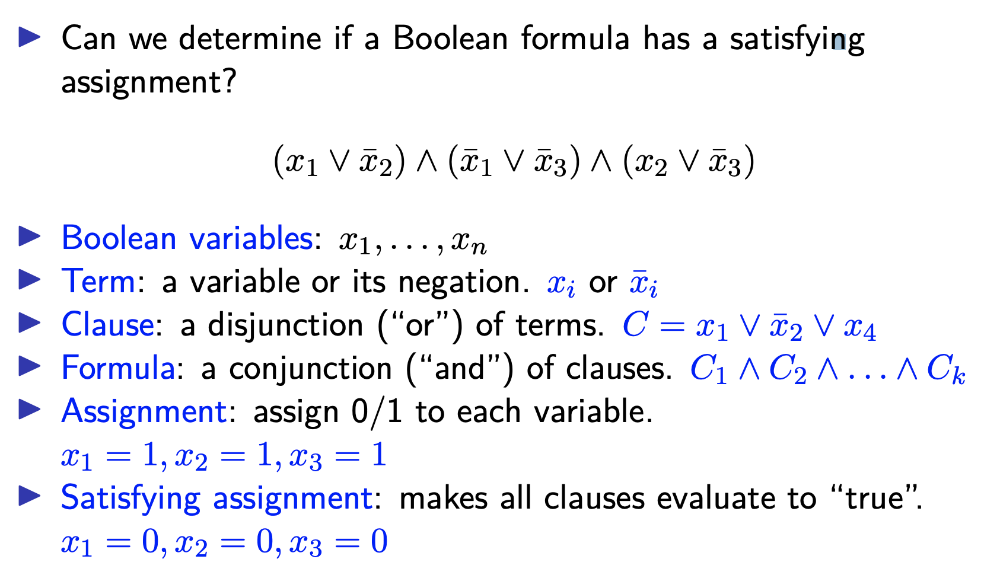

- **Problemlösung:**
    - Erstellen der **Wahrheitstafel** entspricht der Lösung des Problems
        - Ansatz sehr ineffizient und nicht anwendbar mit vielen atomaren Aussagen
    - **Optimierungen:**
        - Äquivalenzumformung
        - Problem direkt in KNF formulieren
        - Nur Teilformeln übersetzen
        - **Formulierungsbeispiel:**
            - Schwarze Pilze, die Nachbarn von giftigen Pilzen sind, sind giftig.
            - 𝑠𝑐h𝑤𝑎𝑟𝑧𝑥,𝑦 ∧ 𝑔𝑖𝑓𝑡𝑖𝑔𝑥+1,𝑦 ∨ 𝑔𝑖𝑓𝑡𝑖𝑔𝑥−1,𝑦 ∨ 𝑔𝑖𝑓𝑡𝑖𝑔𝑥,𝑦+1 ∨ 𝑔𝑖𝑓𝑡𝑖𝑔𝑥,𝑦−1 → 𝑔𝑖𝑓𝑡𝑖𝑔𝑥,𝑦 
                - x = Reihe, y = Spalte 9x9 Grid

- **Disjunktive Normalform (False) und Konjunktive Normalform (True)**

- KNF und DNF aus Wahrheitstabelle
<br> </br>
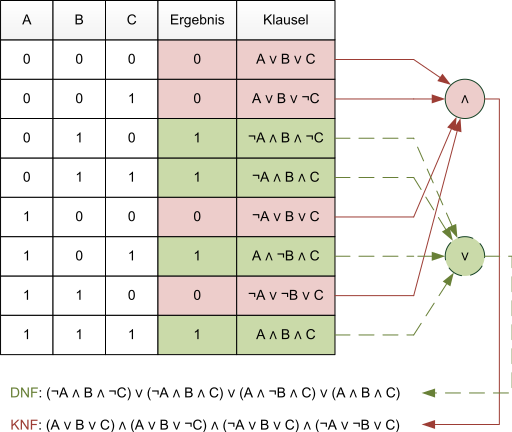
<br> </br>

### Algorithms for solving decision problems


- **Resolution Algorithm**
    - Zustand = Menge von Klauseln (Wissenbasis KB)
    - Suchschritt = Anwenden der Resolutionsregel auf zwei beliebige passende disjunktive Klauseln (z.B. eine enthält a und die andere ein ¬ a)
    - Zieltest = leere Klausel abgeleitet
    - Führe Schritte mit Gegenbeispiel der eigentlichen Formel aus.
    <br> </br>
    - **Zum Beipiel:**
        - Sei KB eine KNF. Zeige, dass hieraus die Formel ¬ c gilt.

!
<br> </br>
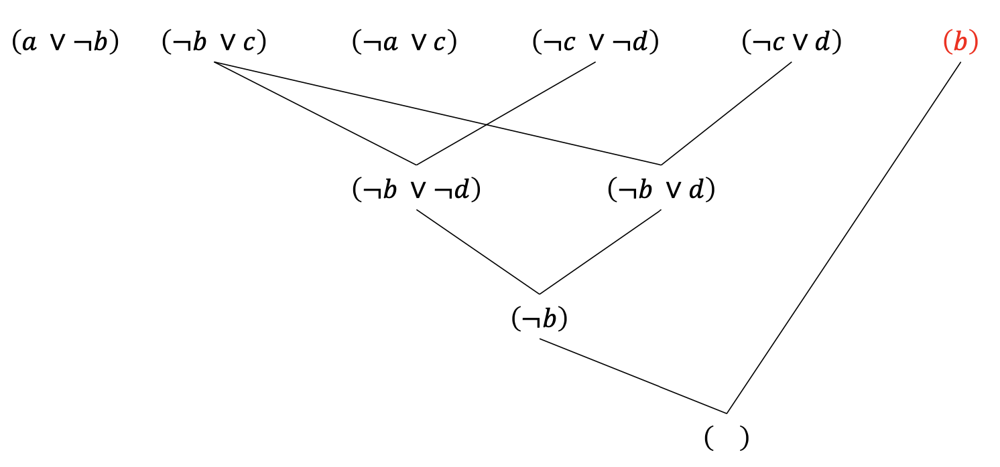
<br> </br>

#### DPLL Algorithm
Wende die folgenden Heuristiken an, wann immer möglich:
-  **Tautology Checking**
    -  Entfernen der Tautologie
-  **Unit Propagation**
    -  Setze A = true und vereinfache die Formel
-  **Pure Literal Deletion**
    -  Setze A = true (bzw. B = false) und vereinfache die Formel

!
<br> </br>
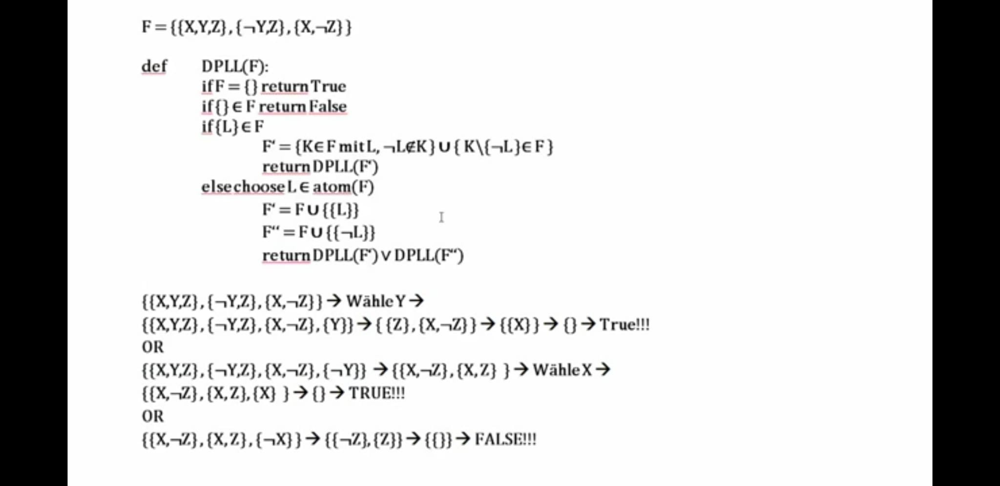
<br> </br>

<br> </br>
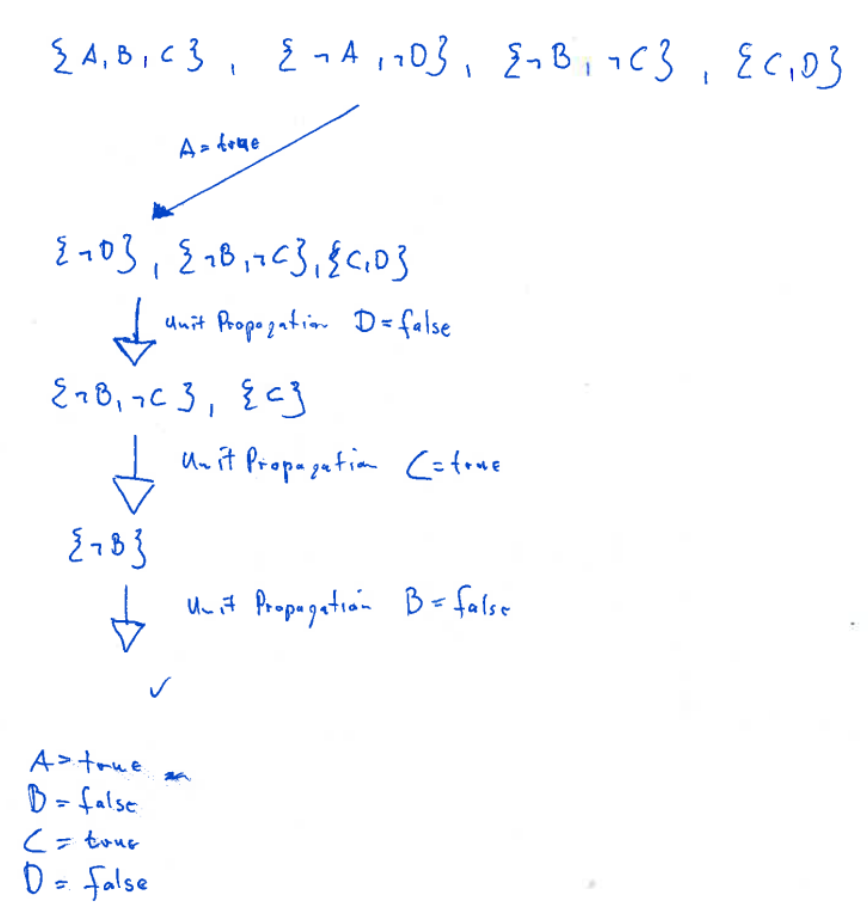
<br> </br>


##### G (Greedy) SAT

- nicht korrekt aber vollständig
- möglicherweise lokale Minima
    - Lösung:
    - Random Walk SAT


### Exkurs - Complexity Classes:

###### P
P is a complexity class that represents the set of all decision problems that can be solved in polynomial time.

That is, given an instance of the problem, the answer yes or no can be decided in polynomial time.

Example

Given a connected graph G, can its vertices be coloured using two colours so that no edge is monochromatic?

Algorithm: start with an arbitrary vertex, color it red and all of its neighbours blue and continue. Stop when you run out of vertices or you are forced to make an edge have both of its endpoints be the same color.

<br> </br>

###### NP
NP is a complexity class that represents the set of all decision problems for which the instances where the answer is "yes" have proofs that can be verified in polynomial time.

This means that if someone gives us an instance of the problem and a certificate (sometimes called a witness) to the answer being yes, we can check that it is correct in polynomial time.

Example

Integer factorisation is in NP. This is the problem that given integers n and m, is there an integer f with 1 < f < m, such that f divides n (f is a small factor of n)?

This is a decision problem because the answers are yes or no. If someone hands us an instance of the problem (so they hand us integers n and m) and an integer f with 1 < f < m, and claim that f is a factor of n (the certificate), we can check the answer in polynomial time by performing the division n / f.

<br> </br>

###### NP-Complete
NP-Complete is a complexity class which represents the set of all problems X in NP for which it is possible to reduce any other NP problem Y to X in polynomial time.

Intuitively this means that we can solve Y quickly if we know how to solve X quickly. Precisely, Y is reducible to X, if there is a polynomial time algorithm f to transform instances y of Y to instances x = f(y) of X in polynomial time, with the property that the answer to y is yes, if and only if the answer to f(y) is yes.

Example

3-SAT. This is the problem wherein we are given a conjunction (ANDs) of 3-clause disjunctions (ORs), statements of the form

(x_v11 OR x_v21 OR x_v31) AND 
(x_v12 OR x_v22 OR x_v32) AND 
...                       AND 
(x_v1n OR x_v2n OR x_v3n)
where each x_vij is a boolean variable or the negation of a variable from a finite predefined list (x_1, x_2, ... x_n).

It can be shown that every NP problem can be reduced to 3-SAT. The proof of this is technical and requires use of the technical definition of NP (based on non-deterministic Turing machines). This is known as Cook's theorem.

What makes NP-complete problems important is that if a deterministic polynomial time algorithm can be found to solve one of them, every NP problem is solvable in polynomial time (one problem to rule them all).

<br> </br>

###### NP-hard
Intuitively, these are the problems that are at least as hard as the NP-complete problems. Note that NP-hard problems do not have to be in NP, and they do not have to be decision problems.

The precise definition here is that a problem X is NP-hard, if there is an NP-complete problem Y, such that Y is reducible to X in polynomial time.

But since any NP-complete problem can be reduced to any other NP-complete problem in polynomial time, all NP-complete problems can be reduced to any NP-hard problem in polynomial time. Then, if there is a solution to one NP-hard problem in polynomial time, there is a solution to all NP problems in polynomial time.

Example

The halting problem is an NP-hard problem. This is the problem that given a program P and input I, will it halt? This is a decision problem but it is not in NP. It is clear that any NP-complete problem can be reduced to this one. As another example, any NP-complete problem is NP-hard.

<br> </br>

###### NP = P

This one is the most famous problem in computer science, and one of the most important outstanding questions in the mathematical sciences. In fact, the Clay Institute is offering one million dollars for a solution to the problem (Stephen Cook's writeup on the Clay website is quite good).

It's clear that P is a subset of NP. The open question is whether or not NP problems have deterministic polynomial time solutions. It is largely believed that they do not. Here is an outstanding recent article on the latest (and the importance) of the P = NP problem: https://cacm.acm.org/magazines/2009/9/38904-the-status-of-the-p-versus-np-problem/fulltext

<br> </br>

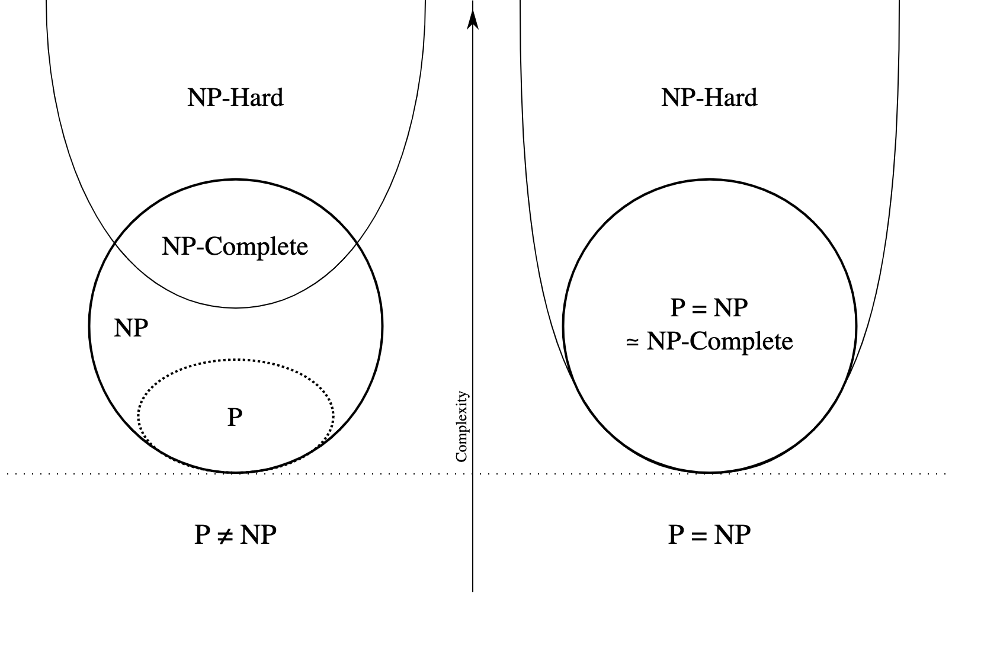

- A yes-or-no problem is in P (Polynomial time) if the answer can be computed in polynomial time.
- A yes-or-no problem is in NP (Non-deterministic Polynomial time) if a yes answer can be verified in polynomial time.
- Intuitively, we can see that if a problem is in P, then it is in NP. Given a potential answer for a problem in P, we can verify the answer by simply recalculating the answer.
- Less obvious, and much more difficult to answer, is whether all problems in NP are in P. Does the fact that we can verify an answer in polynomial time mean that we can compute that answer in polynomial time?
- There are a large number of important problems that are known to be NP-complete (basically, if any these problems are proven to be in P, then all NP problems are proven to be in P). If P = NP, then all of these problems will be proven to have an efficient (polynomial time) solution.
- Most scientists believe that P!=NP. However, no proof has yet been established for either P = NP or P!=NP.

### Exkurs - Implementation: From Graph to Hard-Coding

##### Adjazenzmatrix
- 2 dim array
<br> </br>
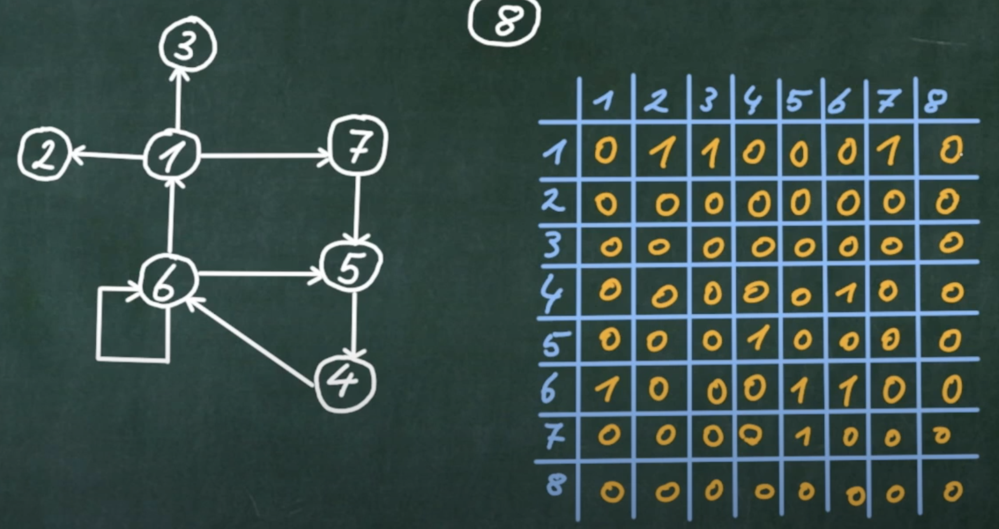
<br> </br>
- **Nachteil:**
    - Auch Informationen die nicht da sind werden abgespeichert (Kanten die nicht existieren mit 0)
<br> </br>
- **Vorteil:** 
    - Konstanter Zeit O(1) Feststellung ob Kante von Knoten A nach Knoten B exisitiert


##### Adjazenzliste
- list
<br> </br>
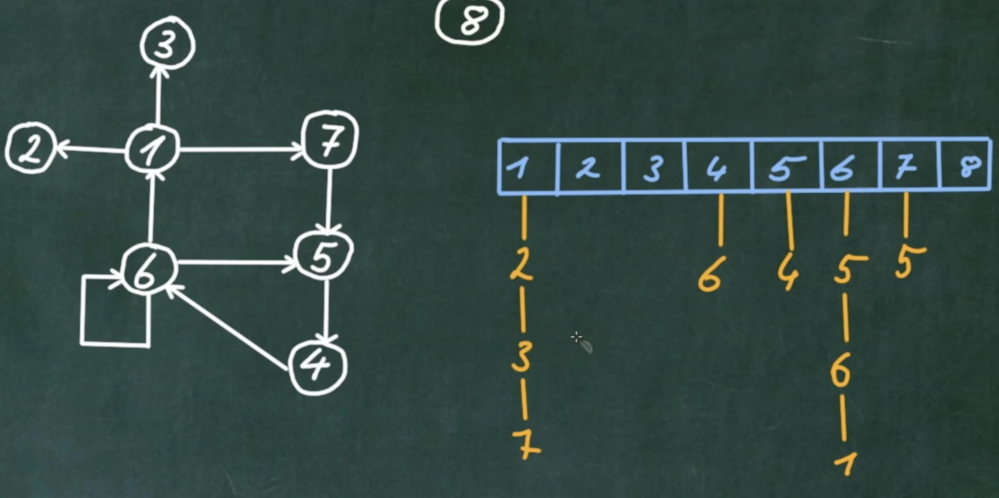

<br> </br>
- **Nachteil:**
    - O(n) Feststellung ob Kante von Knoten A nach Knoten B existiert (Knotenliste mit Kinder muss erst durchlaufen werden)
<br> </br>
- **Vorteil:** 
    - Weniger Speicherbedarf (nicht vorhandene Kanten werden nicht gespeichert)

### How to Solve a Problem from a Computer Scientist Perspective

!
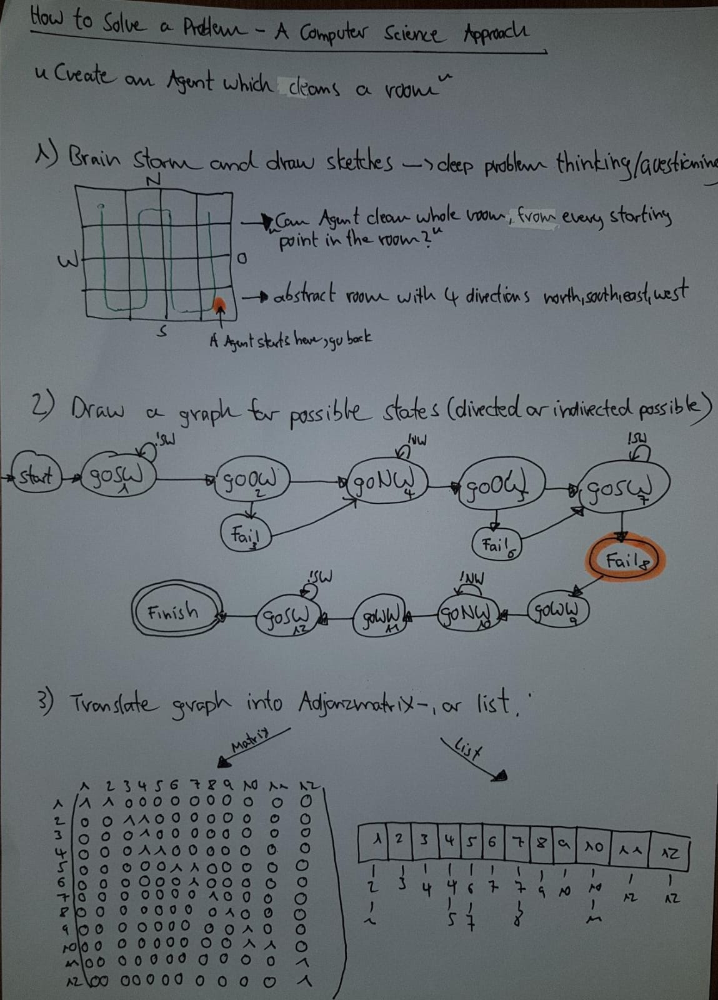

#### 4) Implementation: Write Classes to code the state space in order to run search algorithms

In [1]:
# to do
